# General Setup (Mapping)

In [ ]:
# Import the geopandas and geoplot libraries
!pip install geopandas
!pip install geoplot

In [ ]:
#Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import geopandas as gpd
import geoplot as gplt
import seaborn as sns

# Set up the color scheme:
import mapclassify as mc

In [ ]:
# Load the json file with coordinates
geo_data = gpd.read_file("drive/My Drive/development/MachineLearning/Neighborhoods/data_in/C1_Toronto_Neighborhoods/neighbourhoods.geojson")

# Basic plot with just outlines
gplt.polyplot(
    geo_data,
    projection=gcrs.AlbersEqualArea(),
    edgecolor='darkgrey',
    facecolor='lightgrey',
    linewidth=.3,
    figsize=(16, 12)
)


In [ ]:
def choropleth_quick_plot(geo_data, data, left_col, right_col, display_col, colour_scheme):
  # Show the distribution
  fullData = geo_data.merge(data, left_on=[left_col], right_on=[right_col])
  #fullData.head(2)

  # Initialize the figure
  scheme = mc.Quantiles(fullData[display_col], k=20)

  # Map
  gplt.choropleth(fullData,
      projection=gcrs.AlbersEqualArea(),
      hue=display_col,
      linewidth=.1,
      figsize=(16, 12),
      scheme=scheme,
      cmap=colour_scheme,
      legend=True,
  );

#  Dimensionality Reduction

These are libraries that are required for dimensionality reduction.


In [ ]:
#Libraries for PCA Decomposition
from sklearn.decomposition import PCA

# Libraries for TSNE Decomposition
from sklearn.manifold import TSNE  # For tSNE

#Libraries for UMAP Decomposition
!pip install umap-learn
import umap
#from sklearn.datasets import fetch_openml

We will be covering two types of dimensionality reduction techniques: regression matrix, PCA, TSNE and UMAP

## Regression Matrix

We will load the data and plot a regression matrix using pandas' corrMatrix and Seaborn's Heatmap functions

In [ ]:
#import info
data = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_in/neighbourhood.csv", encoding='utf-8')

#create graph
#data = data.iloc[:, 20:30]
corrMatrix = data.corr()
#sns.heatmap(corrMatrix, annot=True)
fig = plt.figure(figsize=(36,36), dpi = 480)
sns.heatmap(corrMatrix, annot = True, fmt = '.2f')
plt.show()

The regression matrix is huge! We can see clusters of correlations for example neighbourhoods with people with advance degrees are correlated with areas that make the most money. Area where one type of white collar professionals live (ie doctos) are closely correlated with places where other types of white collar professionals live (ie professors).

## PCA Decomposition

We will proceed with several steps such as:

1.   Importing the data
2.   Processing the data
3.   Applying PCA
4.   Plotting the dimensions
5.   Plotting the variance contributions

In [ ]:

# Import info
trn  = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_in/neighbourhood.csv", encoding='utf-8')
trn = trn.dropna()

# Separates the attributes P0-P63 into X_trn
X_trn = trn.filter(regex='\d')
print(X_trn)

# Separates the class variable into y_trn
#y_trn = trn.y
frames = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_out/frames.csv")

y_trn = frames['cluster']

     ac_0_14_perc  ac_15_24_perc  ac_25_54_perc  ac_55_64_perc  \
0            0.14           0.12           0.44           0.12   
1            0.13           0.12           0.38           0.14   
2            0.13           0.14           0.41           0.13   
3            0.14           0.10           0.42           0.15   
4            0.07           0.12           0.48           0.11   
..            ...            ...            ...            ...   
136          0.12           0.09           0.42           0.10   
137          0.15           0.10           0.49           0.11   
138          0.09           0.07           0.46           0.12   
139          0.14           0.17           0.44           0.11   
140          0.13           0.12           0.38           0.12   

     ac_65_over_perc  ac_85_over_perc  ih_hh_5K_perc  ih_hh_10K_perc  \
0               0.15             0.02       0.029827        0.021075   
1               0.20             0.03       0.016996        0.0

[5.31585771e-01 1.91201421e-01 1.20175167e-01 6.03927693e-02
 2.69260049e-02 1.34098200e-02 1.27264584e-02 1.03471829e-02
 5.47287949e-03 4.86492468e-03 3.88350913e-03 3.66103541e-03
 2.98584361e-03 2.59684167e-03 2.24610992e-03 1.74952240e-03
 1.26757788e-03 9.76740502e-04 8.07852088e-04 7.29843235e-04
 3.86194274e-04 3.33540805e-04 2.88608122e-04 2.11126482e-04
 1.39419450e-04 9.99733325e-05 7.76712551e-05 7.41636374e-05
 5.98586785e-05 5.66208732e-05 5.33357199e-05 5.24163600e-05
 4.47733140e-05 3.90540715e-05 3.16180584e-05 2.68054638e-05
 1.22429392e-05 3.29535753e-06 2.00676681e-06]


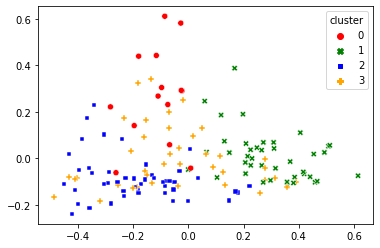

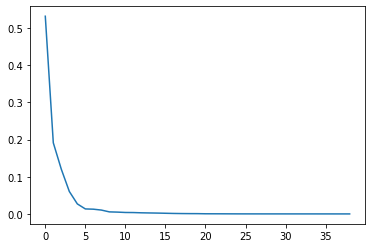

In [ ]:
# Sets up the PCA object
pca = PCA()

# Transforms the training data ('tf' = 'transformed')
trn_tf = pca.fit_transform(X_trn)

# Plot the variance explained by each
print(pca.explained_variance_ratio_)

# Plots the projected data set on the first two principal components and colors by class
sns.scatterplot(
    x=trn_tf[:, 0],
    y=trn_tf[:, 1],
    style=y_trn,
    hue=y_trn,
    palette=['red', 'green', 'blue','orange'])

plt.show()
plt.cla()

In [ ]:
plt.plot(pca.explained_variance_ratio_)


In [ ]:
# Gets the average log likelihood score of training data (with two decimal places)
print("%.2f" % pca.score(X_trn))

126.99


I applied the PCA dimensionality reduction to the data. I coloured the PCA diagram using the clusters identified in Part 1. Even when using 2 components we are able to see see some clustering (visible especially for cluster 1 although it is weaker for the other clusters). Using the "bent elbow" approach of the variance rate, I fond that 5 PCA components is able to capture the variation in the data.





## TSNE Decomposition

We will proceed with several steps such as:

1.   Importing the data
2.   Processing the data
3.   Applying TSNE
4.   Plotting the dimensions


In [ ]:
# Import Info
df = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_in/neighbourhood.csv", encoding='utf-8')
df = df.dropna()

# Separates the attributes P0-P63 into X
X = df.filter(regex='\d')

# Separates the class variable into y
#y = df.y
frames = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_out/frames.csv")
y = frames['cluster']

# Shows the first few rows of the data
df.head()

,name,ngbd_id,ac_0_14_perc,ac_15_24_perc,ac_25_54_perc,ac_55_64_perc,ac_65_over_perc,ac_85_over_perc,edu_hc_none_perc,edu_hc_hschool_perc,...,dw_age_1981_1990,dw_age_1991_2000,dw_age_2001_2005,dw_age_2006_2010,dw_age_2011_2016,labour_status_emp_rate,labour_status_unemp_rate,occ_white_collar,occ_blue_collar,occ_undef
0,City of Toronto,0,0.14,0.12,0.44,0.12,0.15,0.02,0.16,0.24,...,0.098748,0.076955,0.052393,0.060678,0.072606,59.3,8.2,0.601092,0.367813,0.031095
1,Agincourt North,129,0.13,0.12,0.38,0.14,0.20,0.03,0.26,0.30,...,0.213816,0.098136,0.078947,0.038377,0.004934,50.0,9.8,0.466306,0.493333,0.038919
2,Agincourt South-Malvern West,128,0.13,0.14,0.41,0.13,0.17,0.02,0.20,0.30,...,0.202213,0.078672,0.020897,0.045482,0.147511,53.2,9.8,0.497510,0.460166,0.039419
3,Alderwood,20,0.14,0.10,0.42,0.15,0.16,0.03,0.20,0.29,...,0.042254,0.035753,0.016251,0.024919,0.026002,62.4,6.1,0.542857,0.438095,0.019048
4,Annex,95,0.07,0.12,0.48,0.11,0.19,0.03,0.06,0.16,...,0.092819,0.059580,0.044842,0.052681,0.058953,65.8,6.7,0.776071,0.204527,0.019402


In [ ]:
# Sets up the t-SNE object with 2 components
tsne = TSNE(
    n_components=2,
    random_state=1)

# Displays the t-SNE parameters
tsne.get_params()

{'angle': 0.5,
 'early_exaggeration': 12.0,
 'init': 'warn',
 'learning_rate': 'warn',
 'method': 'barnes_hut',
 'metric': 'euclidean',
 'min_grad_norm': 1e-07,
 'n_components': 2,
 'n_iter': 1000,
 'n_iter_without_progress': 300,
 'n_jobs': None,
 'perplexity': 30.0,
 'random_state': 1,
 'square_distances': 'legacy',
 'verbose': 0}

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


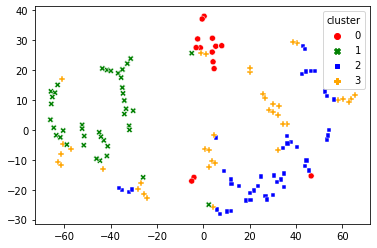

In [ ]:
# Sets up t-SNE with perplexity = 2
tsne = TSNE(
    n_components=2,
    perplexity=4,
    random_state=1)

# Transforms the attribute data
X_tf = tsne.fit_transform(X)

# Creates a scatterplot of the data embedding
sns.scatterplot(
    x=X_tf[:, 0],
    y=X_tf[:, 1],
    style=y,
    hue=y,
    palette=['red', 'green', 'blue','orange'])

I applied the TSNE dimensionality reduction technique to the data. Like with the PCA example, I coloured the TSNE diagram using the clusters identified in Part 1. Similary to the PCA component when using 2 components we are able to see see  clustering for all formal clustering evidently capturing the variature far better than the PCA algprithm.




## UMAP Decomposition

We will proceed with several steps such as:

1.   Importing the data
3.   Applying UMAP
4.   Plotting the dimensions

In [ ]:
#import Info
trn  = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_in/neighbourhood.csv", encoding='utf-8')
trn = trn.dropna()
trn.head()

,name,ngbd_id,ac_0_14_perc,ac_15_24_perc,ac_25_54_perc,ac_55_64_perc,ac_65_over_perc,ac_85_over_perc,edu_hc_none_perc,edu_hc_hschool_perc,...,dw_age_1981_1990,dw_age_1991_2000,dw_age_2001_2005,dw_age_2006_2010,dw_age_2011_2016,labour_status_emp_rate,labour_status_unemp_rate,occ_white_collar,occ_blue_collar,occ_undef
0,City of Toronto,0,0.14,0.12,0.44,0.12,0.15,0.02,0.16,0.24,...,0.098748,0.076955,0.052393,0.060678,0.072606,59.3,8.2,0.601092,0.367813,0.031095
1,Agincourt North,129,0.13,0.12,0.38,0.14,0.20,0.03,0.26,0.30,...,0.213816,0.098136,0.078947,0.038377,0.004934,50.0,9.8,0.466306,0.493333,0.038919
2,Agincourt South-Malvern West,128,0.13,0.14,0.41,0.13,0.17,0.02,0.20,0.30,...,0.202213,0.078672,0.020897,0.045482,0.147511,53.2,9.8,0.497510,0.460166,0.039419
3,Alderwood,20,0.14,0.10,0.42,0.15,0.16,0.03,0.20,0.29,...,0.042254,0.035753,0.016251,0.024919,0.026002,62.4,6.1,0.542857,0.438095,0.019048
4,Annex,95,0.07,0.12,0.48,0.11,0.19,0.03,0.06,0.16,...,0.092819,0.059580,0.044842,0.052681,0.058953,65.8,6.7,0.776071,0.204527,0.019402


     |████████████████████████████████| 88 kB 2.7 MB/s 
     |████████████████████████████████| 1.1 MB 30.2 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=714377755be77765e60e2d680189035719fd4cb77399ee5563cf6654f9ee1abe
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.6-py3-none-any.whl size=53943 sha256=143eddb250191521508f201e4273ab1f2270cd4ea1afb589c2a738a86dd96769
  Stored in directory: /root/.cache/pip/wheels/03/f1/56/f80d72741e400345b5a5b50ec3d929aca581bf45e0225d5c50
Successfully built umap-learn pynndescent
     ngbd_id  ac_0_14_perc  ac_15_24_perc  ac_25_54_perc  ac_55_64_perc  \
0          0          0.14           0.12           0.44           0.12   
1        129          0.13           0.12           0.38           0.14   
2        128          0.13           0.14           0.41           0.13   
3         20

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


[ 0.7058782  -0.45384067 -5.961401   -7.04202    10.642011   -6.382212
 -5.7576213  11.0847025   0.2966177  -5.7612906   0.33992222 -5.6395016
 -0.3505547  -5.3958235   6.877338    9.590278    9.218237   -7.8069725
  7.5444555   3.1378777   9.787642    7.330234    5.440816   -7.019644
 10.914666   -5.7156925  -0.53044564 -7.1624355   8.885748    9.936119
  9.373025    7.075112    0.1491153  10.796384   -7.1424584   9.870249
  9.437707   -6.283701    8.295455   -5.8391957   7.2400494  -7.3390846
  7.441446   10.200107    9.532017    0.9371296   5.877434   10.029367
 -6.5922923   6.2572703  11.020331    2.758404   -6.946655   -5.6631765
 -0.29250422 -7.670958   -5.5588694   9.098336    8.41335    -6.392333
  4.662708    7.153447    2.2482977  10.957336    0.7175852  -5.7355247
  2.1220336   6.5006166  -5.8209033   7.094048    1.9621128  -5.6117287
 11.214677    1.7928554   2.8544376  -0.31832618 -5.72869    -6.3740363
  2.8392694  -5.9340253  11.153425    7.1260405   8.624715    4.580621

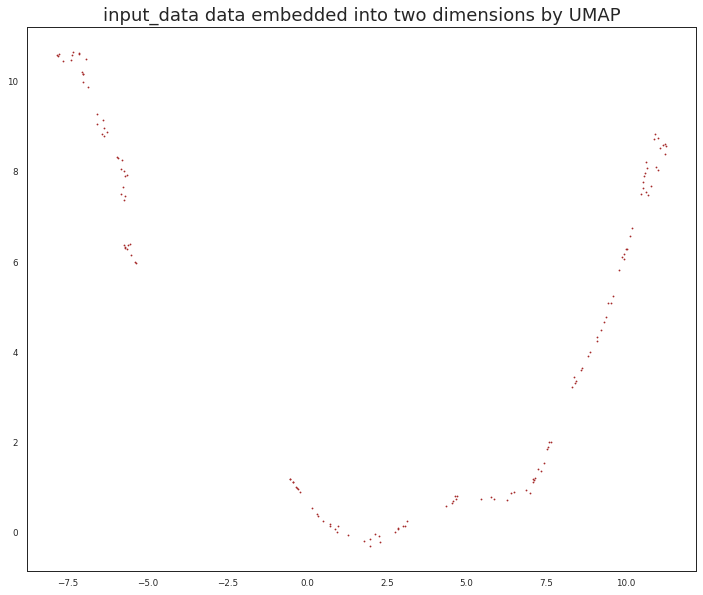

In [ ]:

sns.set(context="paper", style="white")

#Import Info
input_data  = pd.read_csv("drive/My Drive/development/MachineLearning/Neighborhoods/data_in/neighbourhood.csv", encoding='utf-8')
input_data = input_data.drop(input_data.columns[[0]], axis=1)  # df.columns is zero-based pd.Index
input_data = input_data.dropna()
#print(input_data)

#process of UMAP
#mnist = fetch_openml("mnist_784", version=1)
reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(input_data)
print(embedding[:, 0])

In [ ]:
#Making graph
color = "brown"
fig, ax = plt.subplots(figsize=(12, 10))
#color = input_data.target.astype(int)
plt.scatter(embedding[:, 0], embedding[:, 1], c = color, cmap="Spectral", s=1)
#plt.setp(ax, xticks=[], yticks=[])
plt.title("input_data data embedded into two dimensions by UMAP", fontsize=18)
plt.show()

The Umap decomposotion, Like PCA and TSNE also shows clustering. There are two main clumps composed of smaller clusters. Unlike the other methods, the clusters are in a "U" shape.
